13430


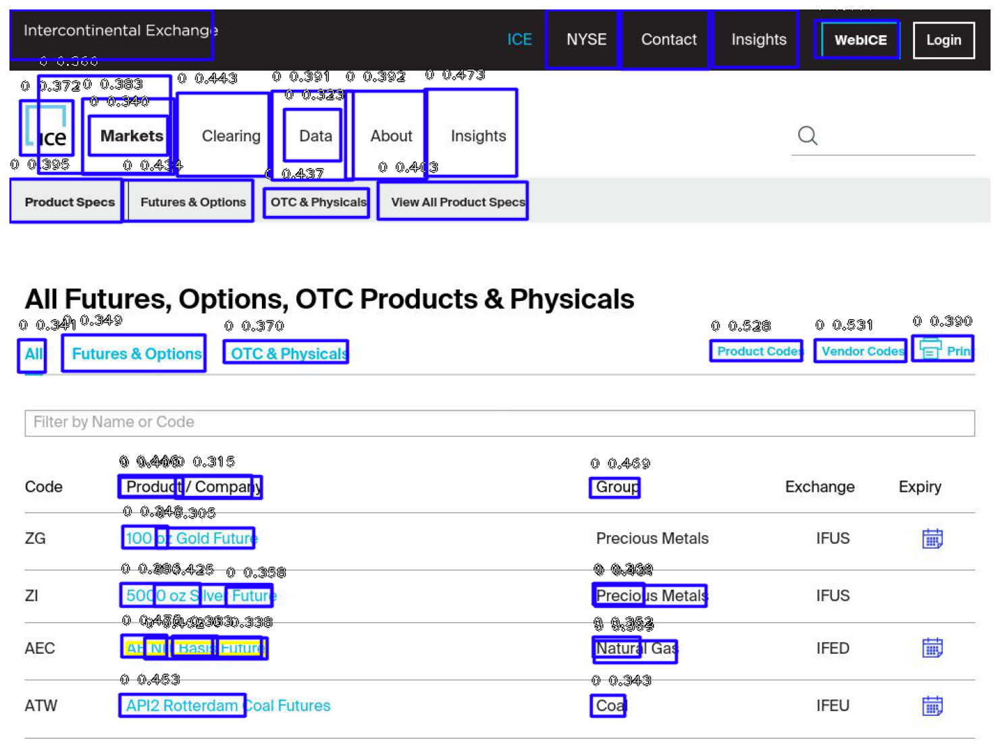

In [21]:
show_detected_random()

10363


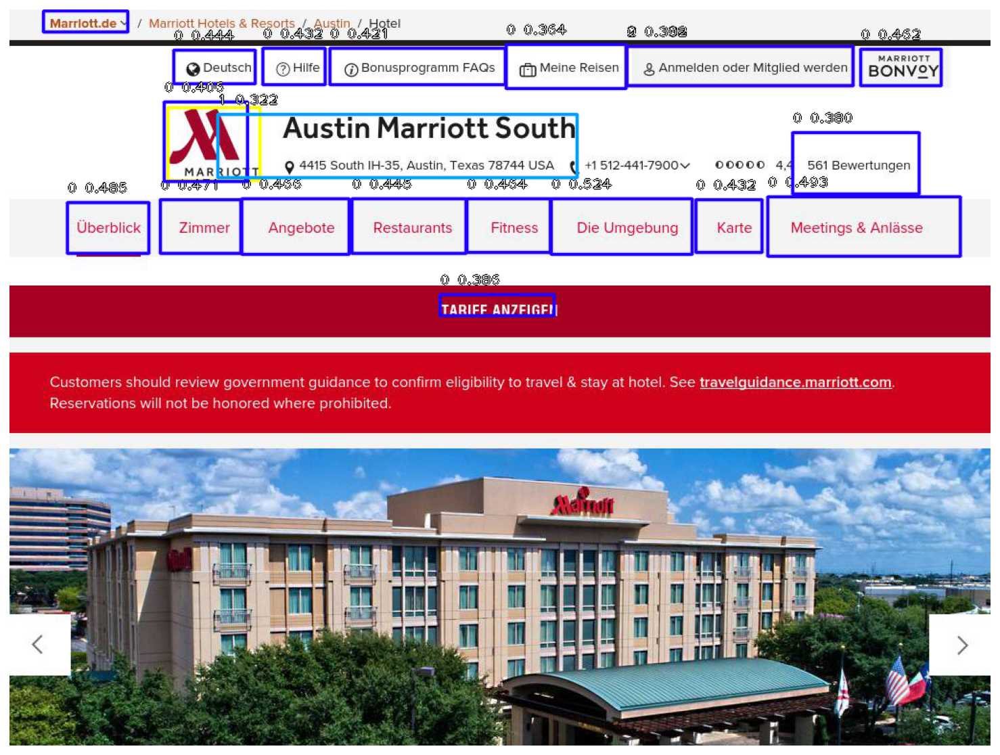

In [22]:
show_detected_random()

1272


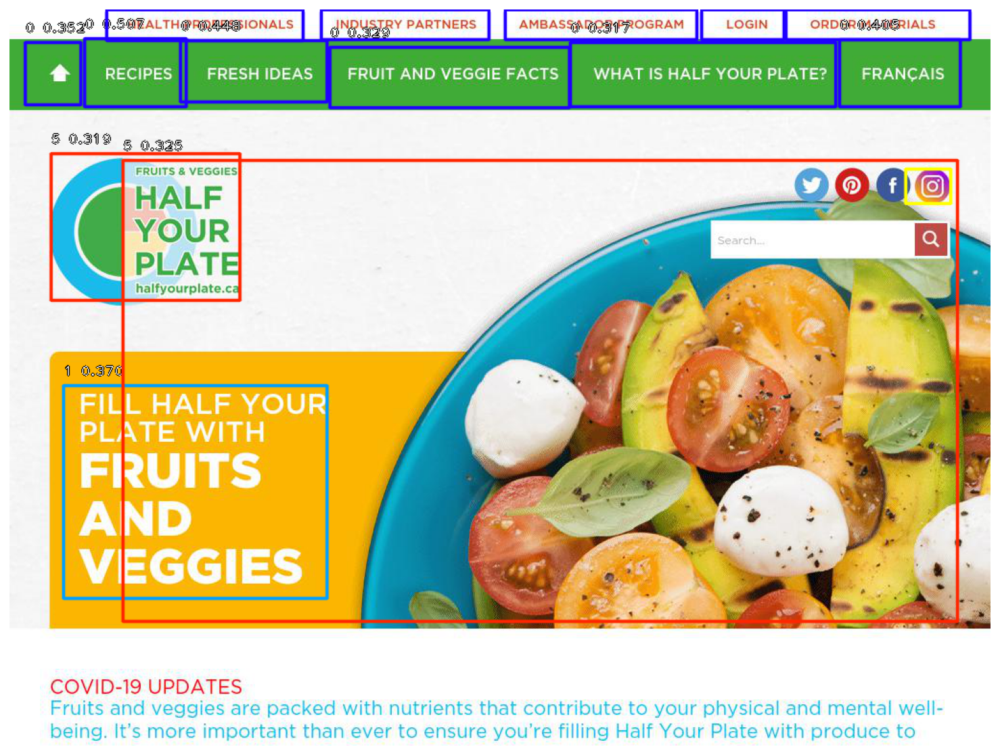

In [23]:
show_detected_random()

10507


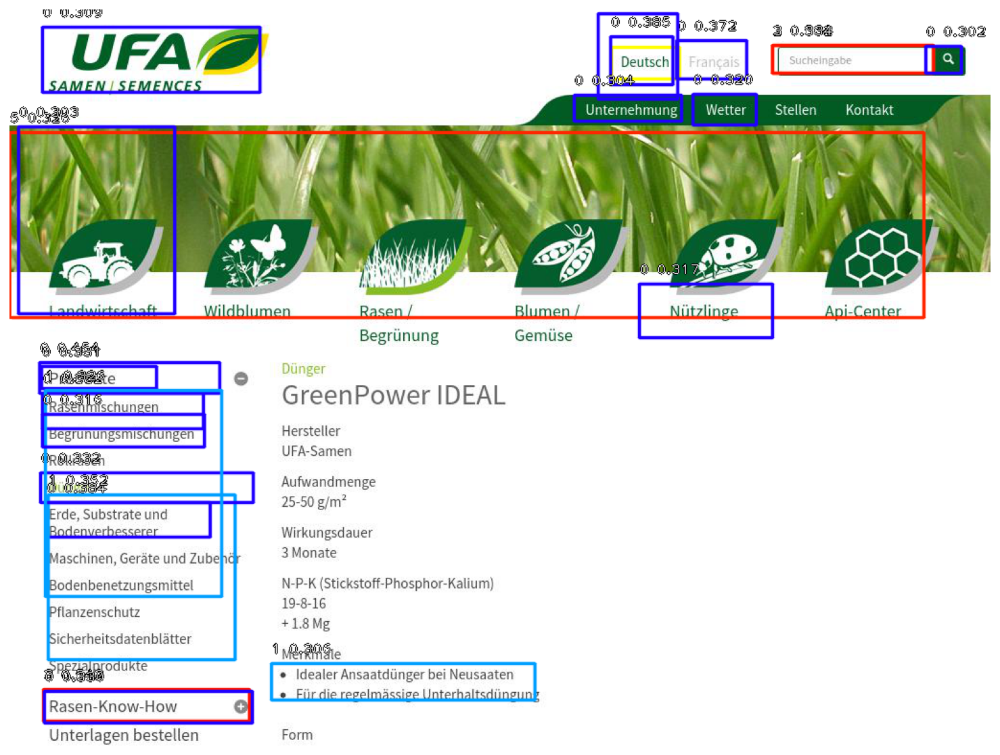

In [24]:
show_detected_random()

19732


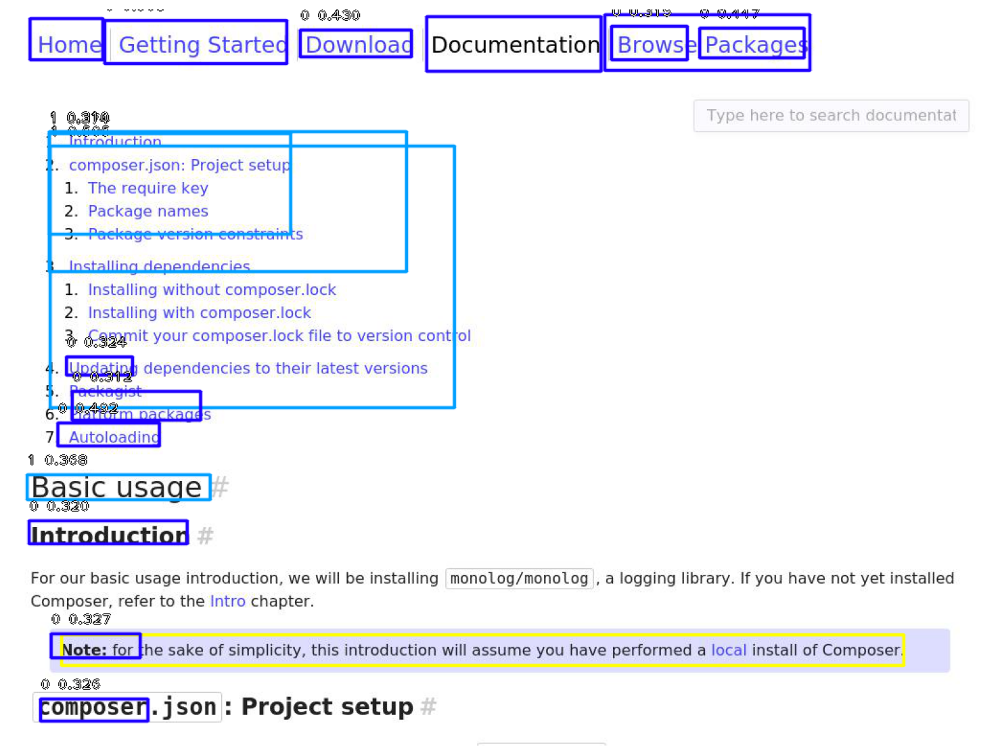

In [25]:
show_detected_random()

6648


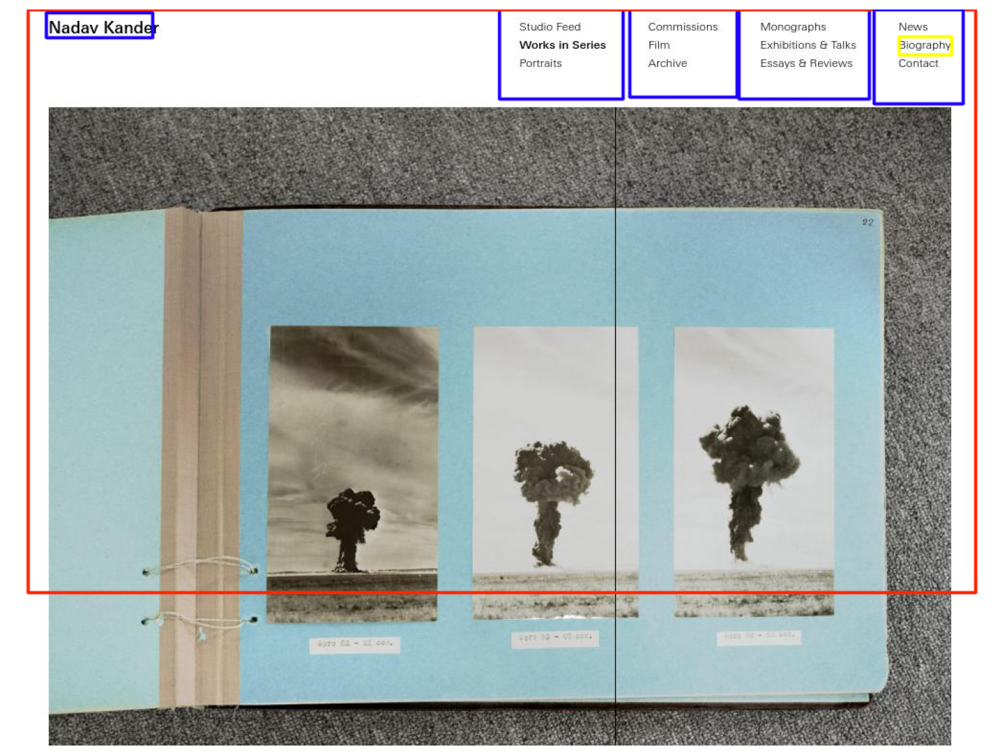

In [20]:
show_detected_random()

16820


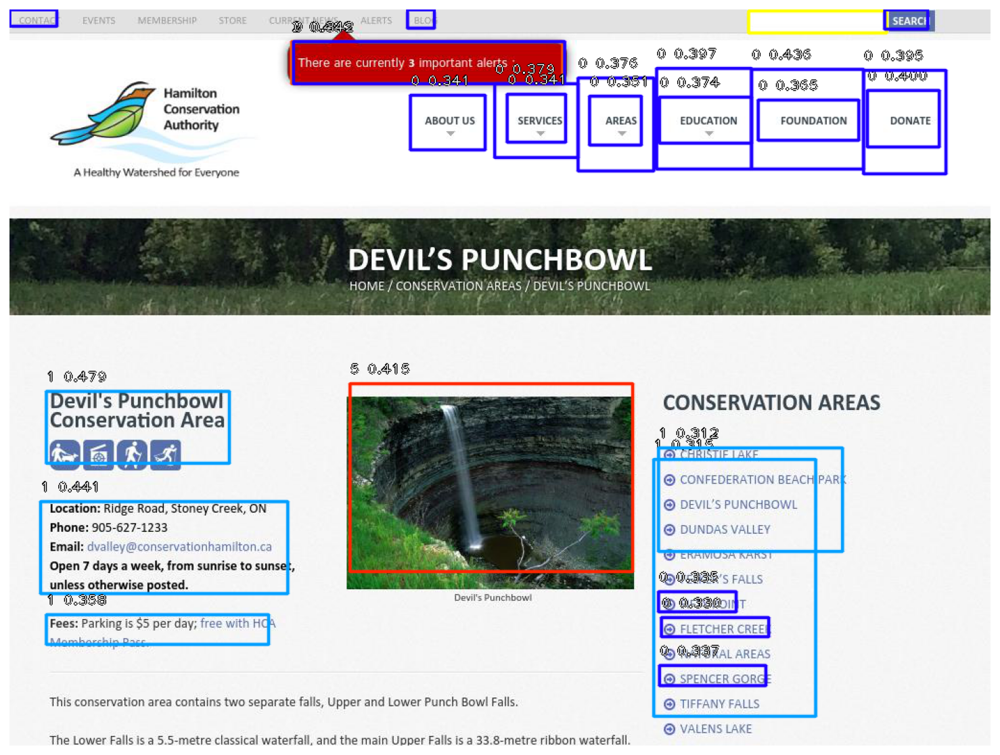

In [26]:
show_detected_random()

7014


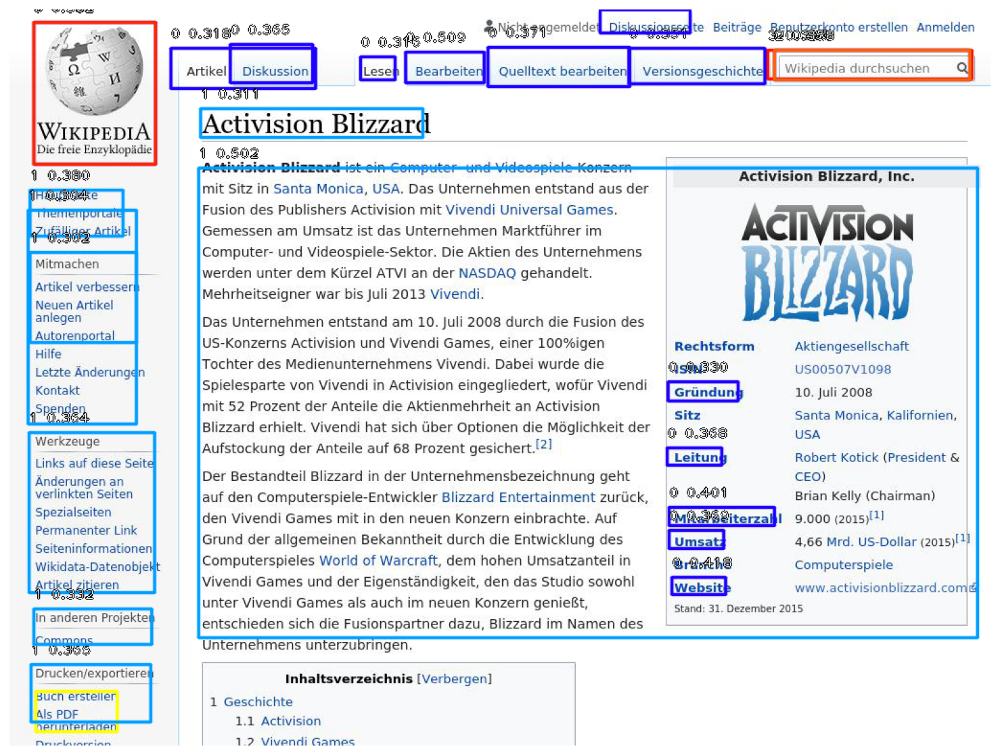

In [27]:
show_detected_random()

20115


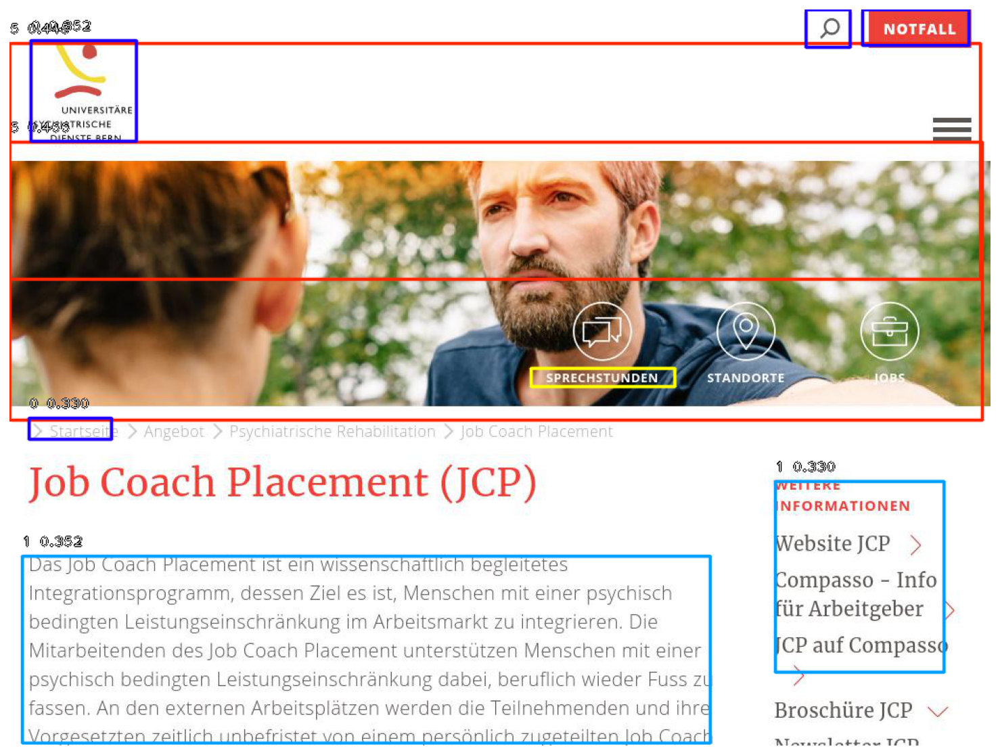

In [28]:
show_detected_random()

8764


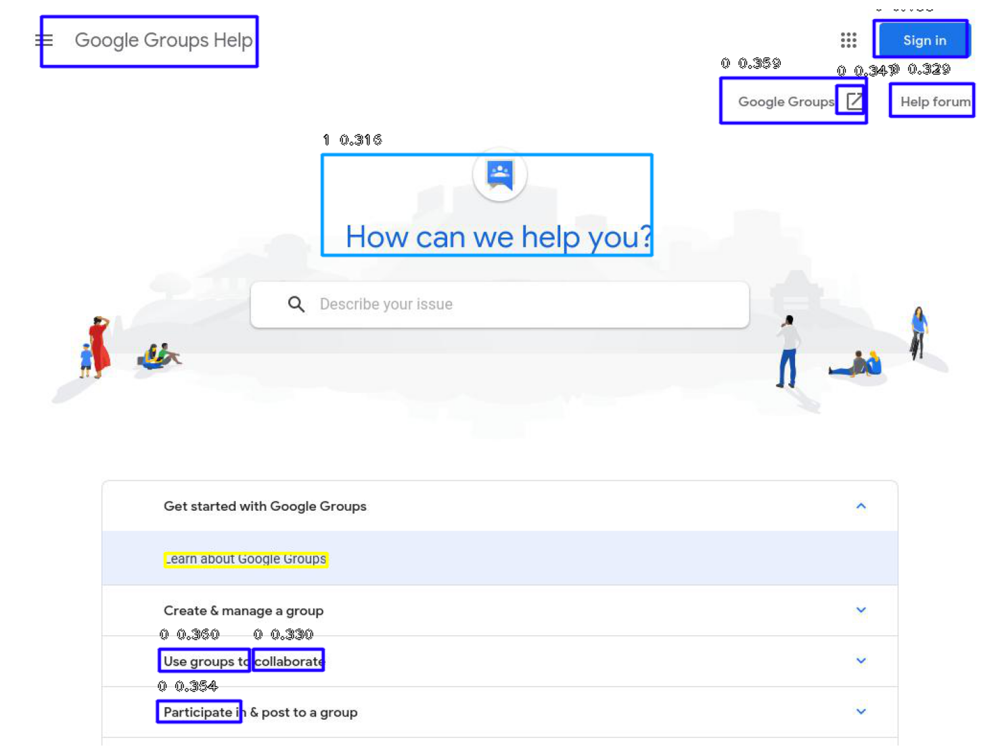

In [29]:
show_detected_random()

10758


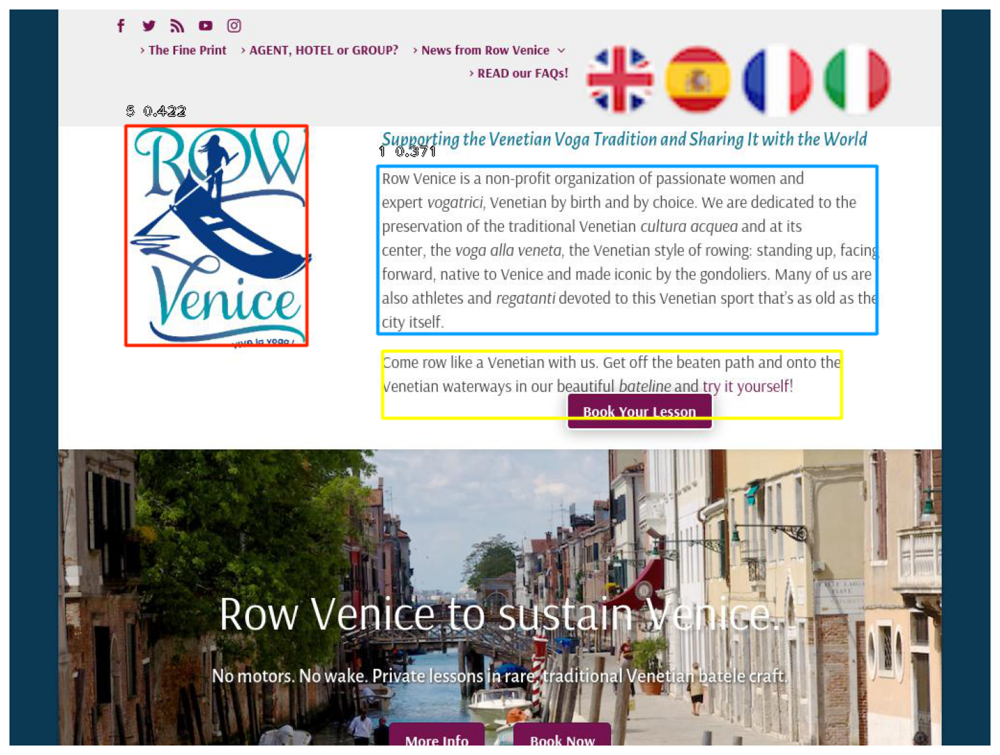

In [30]:
show_detected_random()

15444


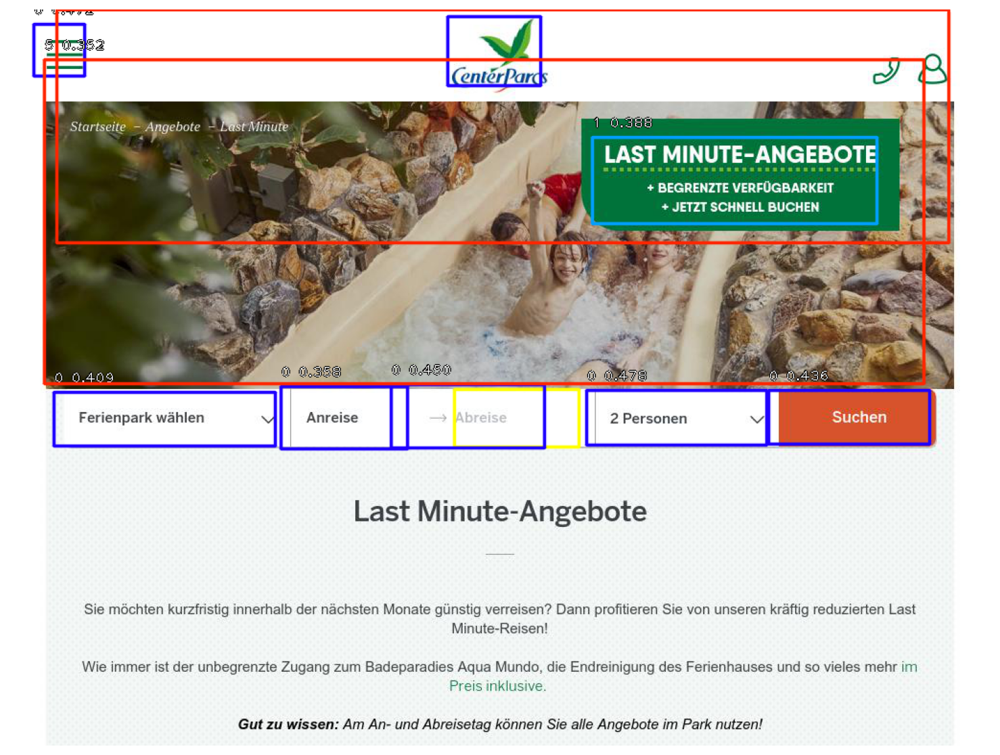

In [31]:
show_detected_random()

14029


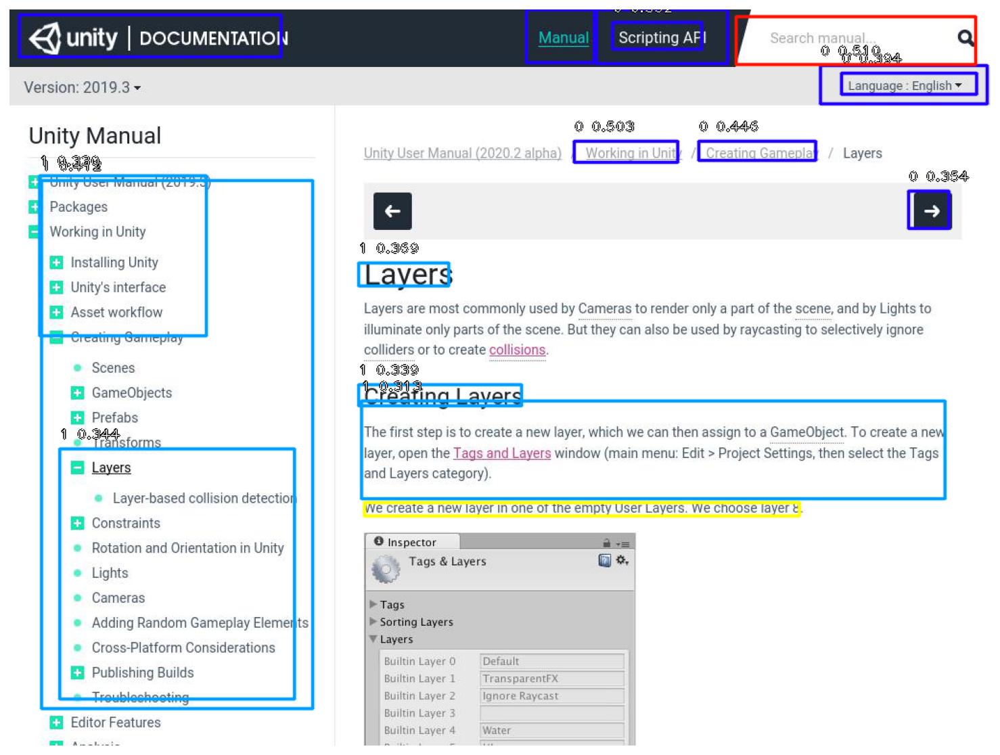

In [32]:
show_detected_random()

16169


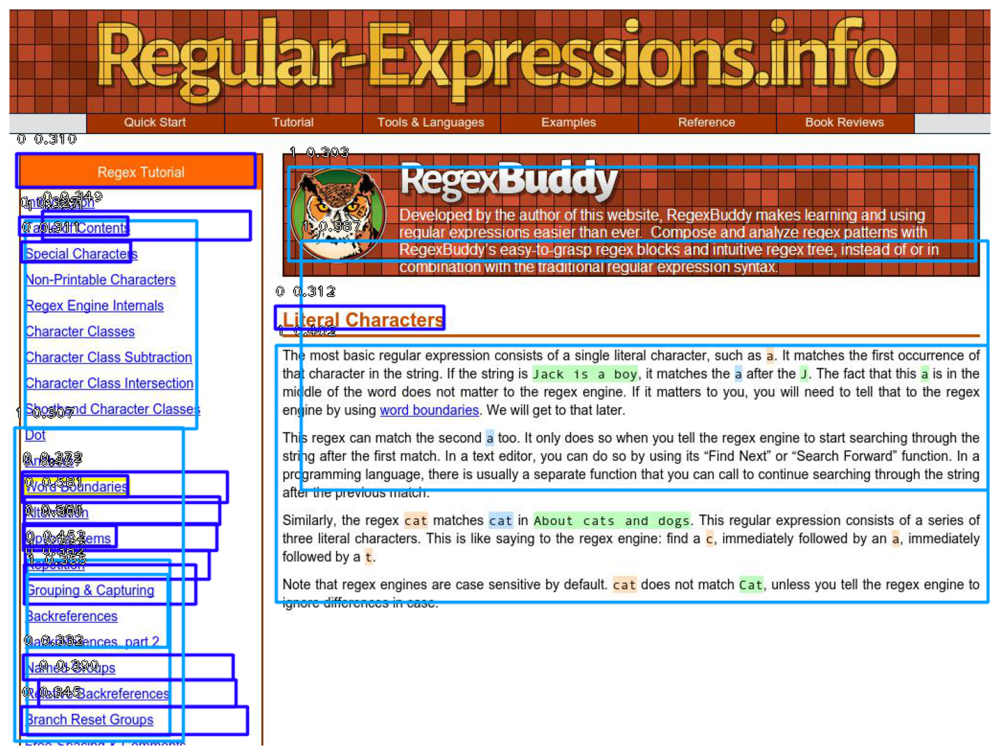

In [33]:
show_detected_random()

In [15]:
!rm test

# Converting to TF1

In [8]:
from keras import backend as K
from keras.models import load_model
from tensorflow.python.saved_model import builder as saved_model_builder
from tensorflow.python.saved_model.signature_def_utils import predict_signature_def
from tensorflow.python.saved_model import tag_constants
tf.keras.backend.set_learning_phase(0)

def export_h5_to_pb(path_to_h5, export_path):

    # Set the learning phase to Test since the model is already trained.
    K.set_learning_phase(0)

    # Load the Keras model
    keras_model = model

    # Build the Protocol Buffer SavedModel at 'export_path'
    builder = saved_model_builder.SavedModelBuilder(export_path)

    # Create prediction signature to be used by TensorFlow Serving Predict API
    signature = predict_signature_def(inputs={"images": keras_model.input},
                                      outputs={"bbox": keras_model.output[0], "scores": keras_model.output[1], "labels": keras_model.output[2]})
    for out in keras_model.output:
        print(out)
    print(keras_model.input)
    with K.get_session() as sess:
        # Save the meta graph and the variables
        builder.add_meta_graph_and_variables(sess=sess, tags=[tag_constants.SERVING],
                                         signature_def_map={"predict": signature})

    builder.save()

In [11]:
!rm -r may10

In [12]:
export_h5_to_pb("./inference_ssd2.h5", "./may10")

Instructions for updating:
This function will only be available through the v1 compatibility library as tf.compat.v1.saved_model.utils.build_tensor_info or tf.compat.v1.saved_model.build_tensor_info.
Tensor("filtered_detections/map/TensorArrayStack/TensorArrayGatherV3:0", shape=(?, 300, 4), dtype=float32)
Tensor("filtered_detections/map/TensorArrayStack_1/TensorArrayGatherV3:0", shape=(?, 300), dtype=float32)
Tensor("filtered_detections/map/TensorArrayStack_2/TensorArrayGatherV3:0", shape=(?, 300), dtype=int32)
Tensor("input_1:0", shape=(?, ?, ?, 3), dtype=float32)
INFO:tensorflow:No assets to save.
INFO:tensorflow:No assets to write.
INFO:tensorflow:SavedModel written to: ./may10/saved_model.pb


In [34]:
print(tf.__version__)

2.2.0


In [20]:
from keras import backend as K
from keras.models import load_model
from tensorflow.python.saved_model import builder as saved_model_builder
from tensorflow.python.saved_model.signature_def_utils import predict_signature_def
from tensorflow.python.saved_model import tag_constants
tf.keras.backend.set_learning_phase(0)

def export_h5_to_pb(path_to_h5, export_path):

    # Set the learning phase to Test since the model is already trained.
    tf.compat.v1.disable_eager_execution()
    K.set_learning_phase(0)

    # Load the Keras model
    keras_model = model

    # Build the Protocol Buffer SavedModel at 'export_path'
    builder = tf.compat.v1.saved_model.Builder(export_path)

    # Create prediction signature to be used by TensorFlow Serving Predict API
    signature = tf.compat.v1.saved_model.predict_signature_def(inputs={"images": keras_model.input},
                                      outputs={"bbox": keras_model.output[0], "scores": keras_model.output[1], "labels": keras_model.output[2]})
    print(keras_model.input)
    for out in keras_model.output:
        print(out)
        
    with tf.compat.v1.keras.backend.get_session() as sess:
        # Save the meta graph and the variables
        builder.add_meta_graph_and_variables(sess=sess, tags=[tag_constants.SERVING],
                                         signature_def_map={"predict": signature})

    builder.save()

In [21]:
export_h5_to_pb("./inference_ssd2.h5", "./may10")

Instructions for updating:
This function will only be available through the v1 compatibility library as tf.compat.v1.saved_model.utils.build_tensor_info or tf.compat.v1.saved_model.build_tensor_info.
Tensor("input_1:0", shape=(None, None, None, 3), dtype=float32)
Tensor("filtered_detections/map/TensorArrayV2Stack/TensorListStack:0", shape=(None, 300, 4), dtype=float32)
Tensor("filtered_detections/map/TensorArrayV2Stack_1/TensorListStack:0", shape=(None, 300), dtype=float32)
Tensor("filtered_detections/map/TensorArrayV2Stack_2/TensorListStack:0", shape=(None, 300), dtype=int32)
INFO:tensorflow:No assets to save.
INFO:tensorflow:No assets to write.
INFO:tensorflow:SavedModel written to: ./may10/saved_model.pb


# TensorflowJS Converter

In [13]:
!tensorflowjs_converter \
    --strip_debug_ops True \
    --input_format=tf_saved_model \
    --output_node_names="filtered_detections/map/TensorArrayV2Stack/TensorListStack:0,filtered_detections/map/TensorArrayV2Stack_1/TensorListStack:0,filtered_detections/map/TensorArrayV2Stack_2/TensorListStack:0" \
    --output_format tfjs_graph_model \
    --saved_model_tags=serve \
    --signature_name predict \
    --skip_op_check \
    ./may10 \
    ./tfjs-may10

2020-05-10 20:17:37.855493: I tensorflow/core/platform/cpu_feature_guard.cc:142] Your CPU supports instructions that this TensorFlow binary was not compiled to use: AVX2 FMA
2020-05-10 20:17:37.872032: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7fc75c66d120 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
2020-05-10 20:17:37.872048: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Host, Default Version
Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Type is unsupported, or the types of the items don't match field type in CollectionDef. Note this is a warning and probably safe to ignore.
Tensor.name is meaningless when eager execution is enabled.
2020-05-10 20:17:41.102077: I tensorflow/core/grappler/devices.cc:60] Number of eligible GPUs (core count >= 8, compute capability >= 0.0): 0 (Note: TensorFlow was not compiled with CUDA support)
2020-05-10 20:17:41.102144:

In [69]:
!tensorflowjs_converter --help

usage: TensorFlow.js model converters. [-h]
                                       [--input_format {keras_saved_model,tf_saved_model,keras,tfjs_layers_model,tf_hub,tf_frozen_model}]
                                       [--output_format {keras_saved_model,keras,tfjs_graph_model,tfjs_layers_model}]
                                       [--signature_name SIGNATURE_NAME]
                                       [--saved_model_tags SAVED_MODEL_TAGS]
                                       [--quantization_bytes {1,2}]
                                       [--split_weights_by_layer] [--version]
                                       [--skip_op_check]
                                       [--strip_debug_ops STRIP_DEBUG_OPS]
                                       [--weight_shard_size_bytes WEIGHT_SHARD_SIZE_BYTES]
                                       [--output_node_names OUTPUT_NODE_NAMES]
                                       [input_path] [output_path]

positional arguments:
  input_path 